<a href="https://colab.research.google.com/github/parulsharma098/EDA-GLOBAL-TERRORISM-ANALYSIS/blob/main/Global_Terrorism_Analysis_Capstone_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## <b> GLOBAL TERRORISM DATABASE </b>


## <b> The Global Terrorism Database (GTD) is an open-source database including information on terrorist attacks around the world from 1970 through 2017. The GTD includes systematic data on domestic as well as international terrorist incidents that have occurred during this time period and now includes more than 180,000 attacks. The database is maintained by researchers at the National Consortium for the Study of Terrorism and Responses to Terrorism (START), headquartered at the University of Maryland.</b>

## <b> **Introduction** </b> 

In the wake of 9/11, terrorism has had an immense effect on shaping the foreign and domestic policies of the Bush, Obama, and Trump presidential administrations (Record, 2004; Obama, 2007; Trump, 2016). However, “despite the enormous resources devoted to countering terrorism, surprisingly little empirical information is available on which strategies are most effective” (LaFree & Dugan, 2009). Furthermore, as evidenced by the 2015 San Bernardino and 2016 Orlando Nightclub shootings, the US remains at risk of attack. For these reasons, the current research aims to perform exploratory analyses on one of the largest publicly available empirical terrorism databases, the Global Terrorism Database (GTD) by the National Consortium for the Study of Terrorism and Responses to Terrorism (START, 2016). Authors of the GTD define a terrorist attack as “the threatened or actual use of illegal force and violence by a non‐state actor to attain a political, economic, religious, or social goal through fear, coercion, or intimidation” (START, 2016). Furthermore, the current research aims to uncover general trends and generate insights that can be used to better understand and thereby combat terrorist attacks on US soil.

## <b> **Project Objective**</b>
This project provides an interactive visualization platform of the global terrorism attacks, to better support the researchers with deeper understandings of the patterns and regularities of the current world terrorism conflicts. This system seeks and presents potential correlations, clustering performances and feature rankings of different countries and parties, associated with types of attacks and casualties.

## <b> Importing Necessary Modules and Libraries </b>

Pandas :- Pandas is used to analyze data. It has functions for analyzing, cleaning, exploring, and manipulating data.

Matplotlib :- Matplotlib is a graph plotting library in python that serves as a visualization utility. Most of the Matplotlib utilities lies under the pyplot submodule.

Numpy :- NumPy is a Python library used for working with arrays. It also has functions for working in domain of linear algebra, fourier transform, and matrices.

Scipy :- This provides more utility functions for optimization, stats and signal processing.Like NumPy, SciPy is open source so we can use it freely.

Plotly :- The plotly is an interactive, open-source plotting library that supports over 40 unique chart types covering a wide range of statistical, financial, geographic, scientific, and 3-dimensional use-cases.

Seaborn :- Seaborn is a library that uses Matplotlib underneath to plot graphs. It will be used to visualize random distributions.

Datetime :- The datetime module supplies classes for manipulating dates and times. While date and time arithmetic is supported, the focus of the implementation is on efficient attribute extraction for output formatting and manipulation.

In [ ]:
# We will start with importing some important libraries 

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
import plotly.express as px
from scipy.interpolate import interp1d

%matplotlib inline

## <b> Getting the data ready for Classification </b>

Now, we need to load our data from the external source, which in this case is uploaded to the drive.

In [ ]:
# Mounting the Google Drive to access data.

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# The variable file_path contains the path of dataset stored in drive. 
file_path = "/content/drive/MyDrive/EDA - Global Terrorism Analysis/Global Terrorism Data.csv"


# Importing terrorism_data File.
terrorism_data = pd.read_csv(file_path, encoding='ISO-8859-1')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning:

Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.



In [ ]:
# Displaying First few rows of data.

terrorism_data.head(2)

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN


In [ ]:
# Using to column attribute to see what type of information is stored in terrorism_data file.

terrorism_data.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [ ]:
# Checking the shape of the dataframe

terrorism_data.shape

(181691, 135)

In [ ]:
# By the info method we can check the Nan values and the datatype of all the columns in our dataframe

terrorism_data.info(verbose= True, null_counts = True)

# By using (null_counts = True) we can get all the Nan values of our columns
# verbose= True will give the datatypes of all the columns

In [ ]:
# The describe() function applies basic statistical computations on the dataset like extreme values,count of data points standard deviation, etc.

terrorism_data.describe()

,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,...,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,1.816910e+05,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181685.000000,...,1.350000e+03,5.630000e+02,7.740000e+02,552.000000,10991.000000,10400.000000,181691.000000,181691.000000,181691.000000,181691.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644,0.045346,131.968501,7.160938,23.498343,-4.586957e+02,1.451452,...,3.172530e+06,5.784865e+05,7.179437e+05,240.378623,4.629242,-29.018269,-4.543731,-4.464398,0.090010,-3.945952
std,1.325957e+09,13.259430,3.388303,8.814045,0.208063,112.414535,2.933408,18.569242,2.047790e+05,0.995430,...,3.021157e+07,7.077924e+06,1.014392e+07,2940.967293,2.035360,65.720119,4.543547,4.637152,0.568457,4.691325
min,1.970000e+11,1970.000000,0.000000,0.000000,0.000000,4.000000,1.000000,-53.154613,-8.618590e+07,1.000000,...,-9.900000e+01,-9.900000e+01,-9.900000e+01,-99.000000,1.000000,-99.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1.991021e+11,1991.000000,4.000000,8.000000,0.000000,78.000000,5.000000,11.510046,4.545640e+00,1.000000,...,0.000000e+00,0.000000e+00,-9.900000e+01,0.000000,2.000000,-99.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,2.009022e+11,2009.000000,6.000000,15.000000,0.000000,98.000000,6.000000,31.467463,4.324651e+01,1.000000,...,1.500000e+04,0.000000e+00,0.000000e+00,0.000000,4.000000,0.000000,-9.000000,-9.000000,0.000000,0.000000
75%,2.014081e+11,2014.000000,9.000000,23.000000,0.000000,160.000000,10.000000,34.685087,6.871033e+01,1.000000,...,4.000000e+05,0.000000e+00,1.273412e+03,0.000000,7.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,2.017123e+11,2017.000000,12.000000,31.000000,1.000000,1004.000000,12.000000,74.633553,1.793667e+02,5.000000,...,1.000000e+09,1.320000e+08,2.750000e+08,48000.000000,7.000000,2769.000000,1.000000,1.000000,1.000000,1.000000


## <b> Data Pre-Processing & Mining for Indicators

The Data mining is the process of extracting and discovering patterns in large data sets. Data Cleaning is one of the most integral part of analysis, in order to get something meaningful out of a huge dataset we need to figure out how to extract a generalized, smaller and more skewed sub-dataFrame out of it. Like here we have defined a new dataframe (terrorism_data_new) which contains only those columns which are needed for our analysis.

In [ ]:
# Now we have created a new dataframe (i.e terrorism_data_new).

terrorism_data_new = terrorism_data[['iyear', 'imonth', 'iday', 'country_txt', 'region_txt', 'provstate', 'city','latitude', 
                                     'longitude', 'success', 'attacktype1_txt', 'targtype1_txt', 'gname', 'weaptype1_txt', 'nkill']]

In [ ]:
# Checking our new updated dataframe

terrorism_data_new.head(2)

,iyear,imonth,iday,country_txt,region_txt,provstate,city,latitude,longitude,success,attacktype1_txt,targtype1_txt,gname,weaptype1_txt,nkill
0,1970,7,2,Dominican Republic,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,1,Assassination,Private Citizens & Property,MANO-D,Unknown,1.0
1,1970,0,0,Mexico,North America,Federal,Mexico city,19.371887,-99.086624,1,Hostage Taking (Kidnapping),Government (Diplomatic),23rd of September Communist League,Unknown,0.0


In [ ]:
# Number of rows and columns in terrorism_data_new.

terrorism_data_new.shape

(181691, 15)

Now, we have renamed the columns in our new dataframe for better understanding also we have used the fillna() function to handle the Nan value.

In [ ]:
# Now we will rename our columns in the new dataframe

terrorism_data_new = terrorism_data_new.rename(columns= {'iyear' : 'year','imonth' : 'month', 'iday' : 'day', 'country_txt' : 'country', 
                                                         'region_txt' : 'region', 'provstate' : 'state', 'attacktype1_txt' : 'attack_type', 
                                                         'targtype1_txt' : 'target_type', 'gname' : 'gang_name', 'weaptype1_txt' : 'weapon_type', 
                                                         'nkill' : 'no_of_kills'  })

In [ ]:
# Checking that the columns are renamed

terrorism_data_new.head(2)

,year,month,day,country,region,state,city,latitude,longitude,success,attack_type,target_type,gang_name,weapon_type,no_of_kills
0,1970,7,2,Dominican Republic,Central America & Caribbean,NaN,Santo Domingo,18.456792,-69.951164,1,Assassination,Private Citizens & Property,MANO-D,Unknown,1.0
1,1970,0,0,Mexico,North America,Federal,Mexico city,19.371887,-99.086624,1,Hostage Taking (Kidnapping),Government (Diplomatic),23rd of September Communist League,Unknown,0.0


In [ ]:
# Now we will check the info of the new dataset

terrorism_data_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 15 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   year         181691 non-null  int64  
 1   month        181691 non-null  int64  
 2   day          181691 non-null  int64  
 3   country      181691 non-null  object 
 4   region       181691 non-null  object 
 5   state        181270 non-null  object 
 6   city         181257 non-null  object 
 7   latitude     177135 non-null  float64
 8   longitude    177134 non-null  float64
 9   success      181691 non-null  int64  
 10  attack_type  181691 non-null  object 
 11  target_type  181691 non-null  object 
 12  gang_name    181691 non-null  object 
 13  weapon_type  181691 non-null  object 
 14  no_of_kills  171378 non-null  float64
dtypes: float64(3), int64(4), object(8)
memory usage: 20.8+ MB


In [ ]:
# Handeling the Nan values using the fillna() method
 
terrorism_data_new['state'] = terrorism_data_new['state'].fillna('unknown')
terrorism_data_new['city'] = terrorism_data_new['city'].fillna('unknown')
terrorism_data_new['no_of_kills'] = terrorism_data_new['no_of_kills'].fillna(0)


In [ ]:
# checking for the Nan values

terrorism_data_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 15 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   year         181691 non-null  int64  
 1   month        181691 non-null  int64  
 2   day          181691 non-null  int64  
 3   country      181691 non-null  object 
 4   region       181691 non-null  object 
 5   state        181691 non-null  object 
 6   city         181691 non-null  object 
 7   latitude     177135 non-null  float64
 8   longitude    177134 non-null  float64
 9   success      181691 non-null  int64  
 10  attack_type  181691 non-null  object 
 11  target_type  181691 non-null  object 
 12  gang_name    181691 non-null  object 
 13  weapon_type  181691 non-null  object 
 14  no_of_kills  181691 non-null  float64
dtypes: float64(3), int64(4), object(8)
memory usage: 20.8+ MB


In [ ]:
# Now we will check the sum of the Nan values present in all of the columns

terrorism_data_new.isnull().sum()


year              0
month             0
day               0
country           0
region            0
state             0
city              0
latitude       4556
longitude      4557
success           0
attack_type       0
target_type       0
gang_name         0
weapon_type       0
no_of_kills       0
dtype: int64

<b>**Exploratory Data Analysis**  </b>:- Exploratory Data Analysis, or EDA, is an important step in any Data Analysis or Data Science project. EDA is the process of investigating the dataset to discover patterns, and anomalies (outliers), and form hypotheses based on our understanding of the dataset.EDA involves generating summary statistics for numerical data in the dataset and creating various graphical representations to understand the data better.


<b> **Data Visualisation** </b> :- Data Visualization is the process of analyzing data in the form of graphs or maps, making it a lot easier to understand the trends or patterns in the data.

<b> **Word Cloud** </b> :- Word Cloud is a data visualization technique used for representing text data in which the size of each word indicates its frequency or importance. Significant textual data points can be highlighted using a word cloud. 





/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: FutureWarning:

In a future version of pandas all arguments of Series.dropna will be keyword-only



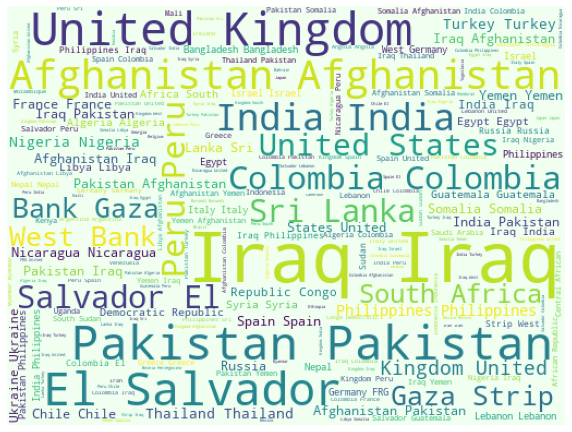

In [ ]:
# Importing important liberaries for ploting word cloud.

from wordcloud import WordCloud
from scipy import signal

# Ploting word cloud for country
# The size of the text of every country indicates the frequency of the attacks.

city = terrorism_data_new.country.dropna(False)
plt.subplots(figsize=(10,10))

wordcloud = WordCloud(background_color = '#F0FFF0',width = 512,height = 384).generate(' '.join(city))

plt.axis('off')
plt.imshow(wordcloud)

## <b> **Visualising the hot zones under attack over the world** </b>

In [ ]:
# Importing the important libraries

import plotly.express as px
from scipy.interpolate import interp1d

In [ ]:


heatmap = terrorism_data_new.groupby(['country','longitude','latitude','year']).count()['region'].reset_index()
heatmap = heatmap.rename(columns = {'region':'attacks'})

In [ ]:
list1= heatmap.attacks.tolist()

In [ ]:
m = interp1d([1,max(list1)],[5,16])
circle_redius = m(list1)

In [ ]:
fig = px.density_mapbox(heatmap , lat ='latitude' , lon = 'longitude',radius = circle_redius,zoom = 0 ,
                        mapbox_style = 'stamen-terrain', animation_group='year', animation_frame = 'year')

In [ ]:
fig

## <b> 3.2 Total number of attacks in every year by region


In [ ]:
attacks_per_year = terrorism_data_new.groupby(['year', 'region']).count().unstack()['country']

Text(0.5, 0, 'Year')

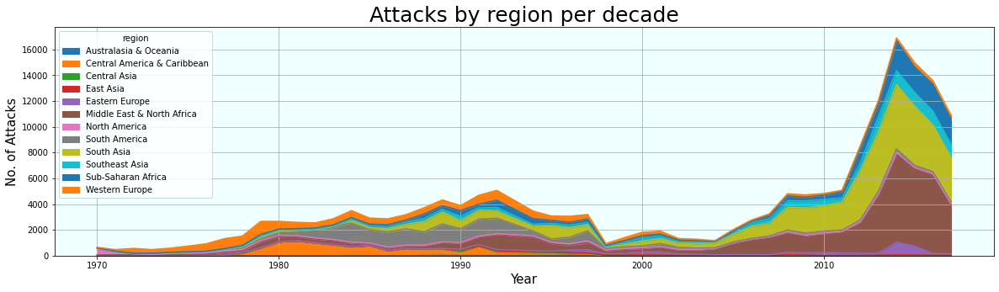

In [ ]:
# Plotting the Multiline Chart
attacks_per_year.plot(grid = True, kind='area', figsize=(20,5)).patch.set_facecolor('#f0ffff')

# Setting a title for the chart.
plt.title('Attacks by region per decade', fontsize = 25)

# Setting the x and y axis labels
plt.ylabel('No. of Attacks', fontsize = 15)
plt.xlabel('Year', fontsize = 15)

## Conclusion :- From the above graph we can conclude that after the year 2010 their is a hude spike in the terrorist attacks.

## <b> 3.3 Analysing the trend across the year

In [ ]:
yearly_trend = terrorism_data_new.year.value_counts().sort_index(ascending=True)

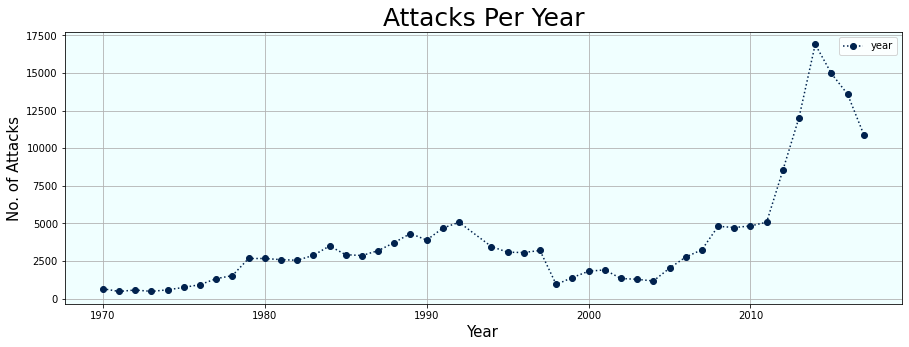

In [ ]:
# Plotting the line Chart to show the trend across the year
yearly_trend.plot(kind = 'line', marker = 'o', ls = ':', grid = True, colormap = "cividis", figsize=(15,5)).patch.set_facecolor('#f0ffff')

# setting a title of the chart.
plt.title('Attacks Per Year', fontsize = 25)

# setting the x and y axis labels
plt.ylabel('No. of Attacks', fontsize = 15)
plt.xlabel('Year', fontsize = 15)

# showing legends on the plot
plt.legend()

## <b> 3.4 In the above graph it is visible that for year 2014 their where most terrorist attack so analysing which region got attacked most

In [ ]:
attacks_in_2014 = terrorism_data_new[terrorism_data_new['year'] == 2014]
attack_2014 = attacks_in_2014['region'].value_counts().to_frame()

Text(0.5, 0, 'Year')

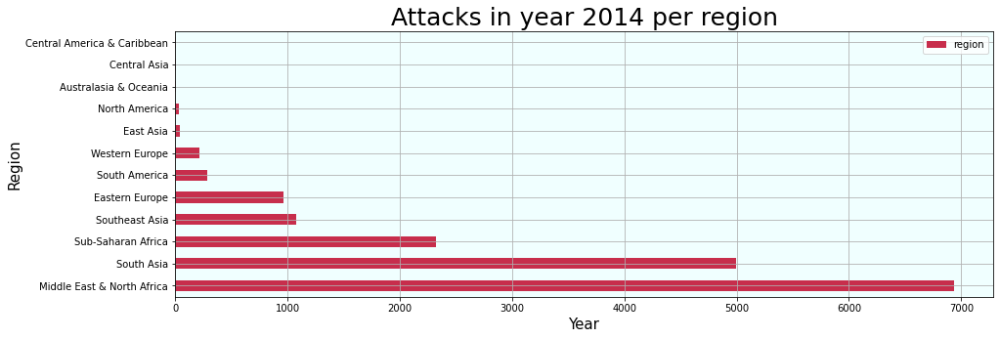

In [ ]:
# Plotting the line Chart to show the trend.
palette = sns.color_palette("Spectral", 12).as_hex()
attack_2014.plot(kind = 'barh',color = palette, grid = True, figsize=(15,5)).patch.set_facecolor('#f0ffff')

# setting a title of the chart.
plt.title('Attacks in year 2014 per region', fontsize = 25)

# setting the x and y axis labels
plt.ylabel('Region', fontsize = 15)
plt.xlabel('Year', fontsize = 15)

## <b> 3.5 Top 10 countries which where most attacked

In [ ]:
top_10_countries = terrorism_data_new['country'].value_counts().head(10)

Text(0, 0.5, 'Countries')

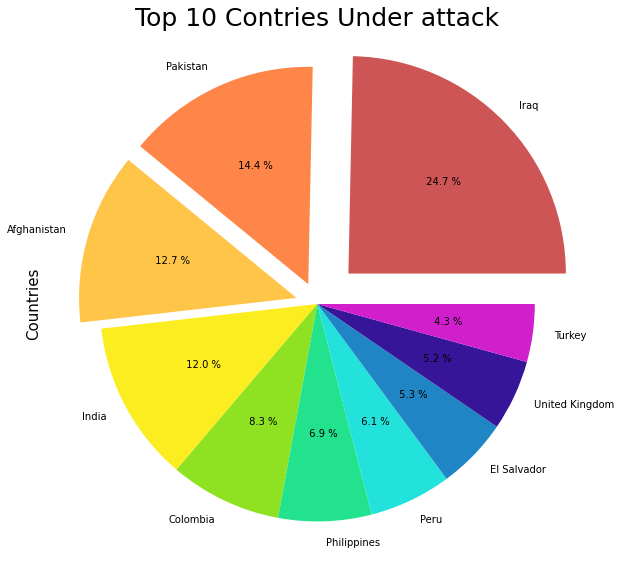

In [ ]:
# Defining the explode
myexplode = [0.2, 0.1, 0.1, 0, 0, 0, 0, 0, 0, 0 ]
color_set = ["#CD5555","#ff8649","#ffc549","#fced20","#8fe222","#22e28e","#22e2db","#1f85c4","#361599","#d11fce"]

# Plotting the Pie Chart
top_10_countries.plot(kind = 'pie', figsize=(20,10), explode = myexplode,autopct ='% 1.1f %%',colors = color_set)

# Set a title of the chart.
plt.title('Top 10 Contries Under attack', fontsize = 25)

# Set the y label
plt.ylabel('Countries', fontsize = 15)

## <b> 3.6 Top 10 states under attack

In [ ]:
top_10_states = terrorism_data_new['state'].value_counts().head(10)

Text(0, 0.5, 'States')

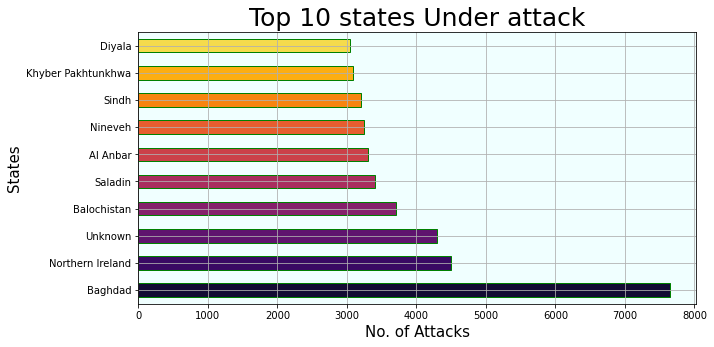

In [ ]:
# Plotting the horizontal Bar graph

palette = sns.color_palette("inferno", 10).as_hex()
top_10_states.plot(kind = 'barh', figsize=(10,5), color= palette, edgecolor='green', grid = True).patch.set_facecolor('#f0ffff')

# Set a title of the current axes.
plt.title('Top 10 states Under attack', fontsize = 25)

# Set the x and y axis label
plt.xlabel('No. of Attacks', fontsize = 15)
plt.ylabel('States', fontsize = 15)

## 3.7 <b>  Which attack type is the most common

In [ ]:
common_attack_type = terrorism_data_new['attack_type'].value_counts()

Text(0, 0.5, 'No. of attacks')

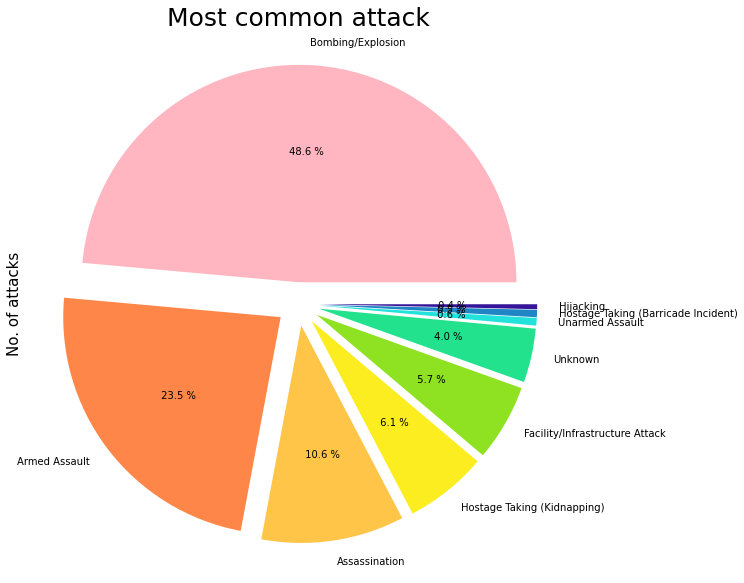

In [ ]:
# Defining the explode
myexplode = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1 ]
color_set = ["#FFB6C1","#ff8649","#ffc549","#fced20","#8fe222","#22e28e","#22e2db","#1f85c4","#361599"]

# Plotting the Pie Chart
common_attack_type.plot(kind = 'pie',figsize=(20,10), explode = myexplode, autopct ='% 1.1f %%', colors = color_set)

# Set a title of the chart.
plt.title('Most common attack', fontsize = 25)

# Set the y label
plt.ylabel('No. of attacks', fontsize = 15)

## <b> 3.8 Which gang attacked the most <b>

In [ ]:
leading_gangs = terrorism_data_new['gang_name'].value_counts().head(10)

Text(0, 0.5, 'No. of attacks')

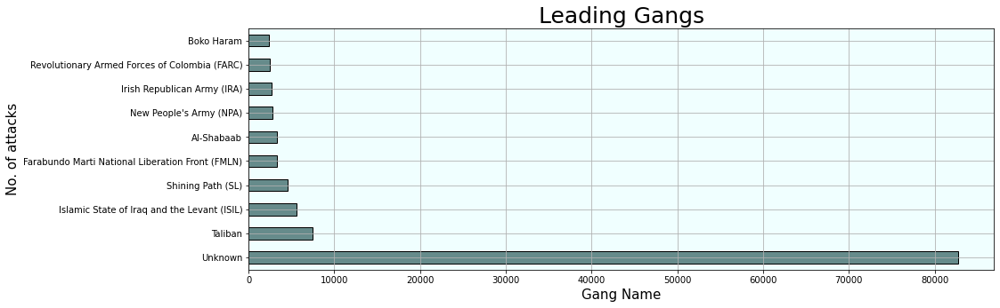

In [ ]:
# Plotting the horizontal Bar graph
leading_gangs.plot(kind = 'barh', figsize=(15,5), color = '#668B8B' , edgecolor='black', grid = True).patch.set_facecolor('#f0ffff')

# Set a title for our chart
plt.title('Leading Gangs', fontsize = 25)

# Set the x and y axis label
plt.xlabel('Gang Name', fontsize = 15)
plt.ylabel('No. of attacks', fontsize = 15)

## <b> 3.9 which attack type is used by the most deadly gang :- Taliban

In [ ]:
# Installing the needed library

!pip install squarify
import squarify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
gname = "Taliban"
def treeplot(data,gang_name):
    plt.subplots(figsize=(10, 10))
    w_t = pd.DataFrame(terrorism_data_new[terrorism_data_new['gang_name']==gname]['weapon_type'].value_counts())
    w_t.reset_index(level=0,inplace=True)
    t = squarify.plot(sizes=w_t["weapon_type"],label=w_t["index"],alpha=0.8)
    plt.show()

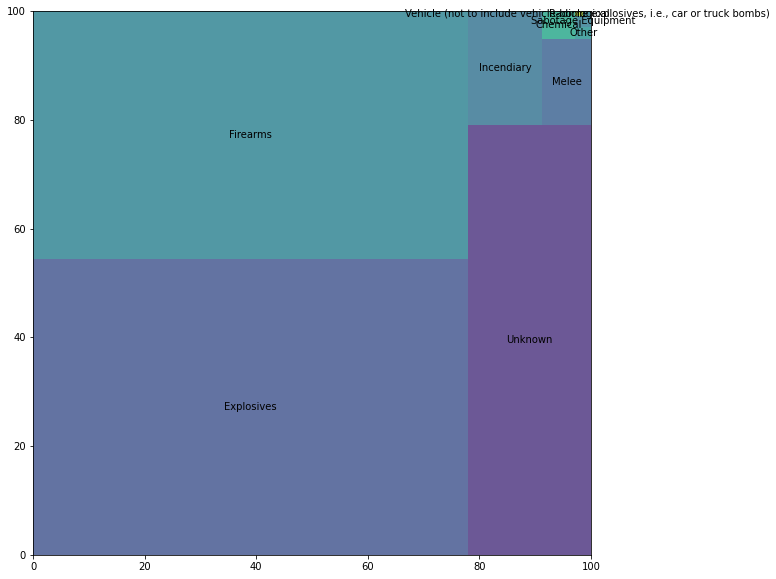

In [ ]:
# Plotting the Heat Map
treeplot(terrorism_data_new,"Taliban")

## Conclusion :- Firearms and Explovies have been Taliban's favorite weapon type. This has been same for many terrorist groups.


## <b> 3.10 What was the most common target of the terrorist <b>

In [ ]:
common_targets = terrorism_data_new['target_type'].value_counts().head(10)

Text(0, 0.5, 'No. of attacks')

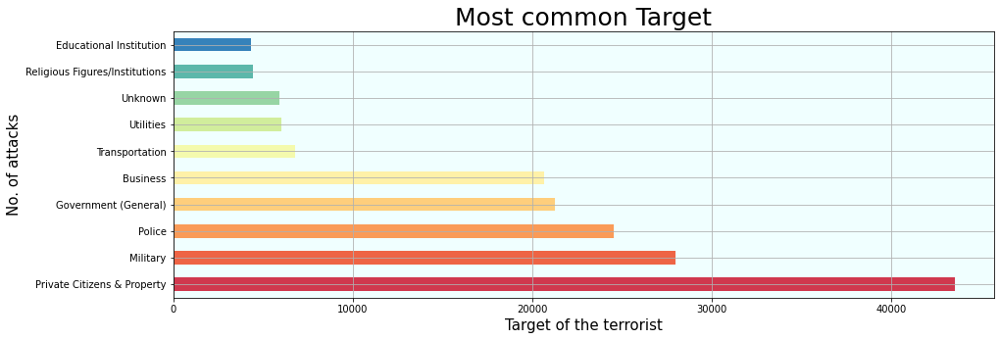

In [ ]:
# Plotting the horizontal Bar graph

palette = sns.color_palette("Spectral", 10).as_hex()
common_targets.plot(kind = 'barh',figsize=(15,5), color = palette , grid = True).patch.set_facecolor('#f0ffff')

# Set a title of the current axes.
plt.title('Most common Target', fontsize = 25)

# Set the x and y axis label
plt.xlabel('Target of the terrorist', fontsize = 15)
plt.ylabel('No. of attacks', fontsize = 15)

## Conclusion :- The most common target of the Terrorist are the 'Private Citizens & Property' 

## <b> 3.11 Which year has the most number of casualties

In [ ]:
casualties = terrorism_data_new.groupby('year').sum()['no_of_kills']

Text(0.5, 0, 'Year')

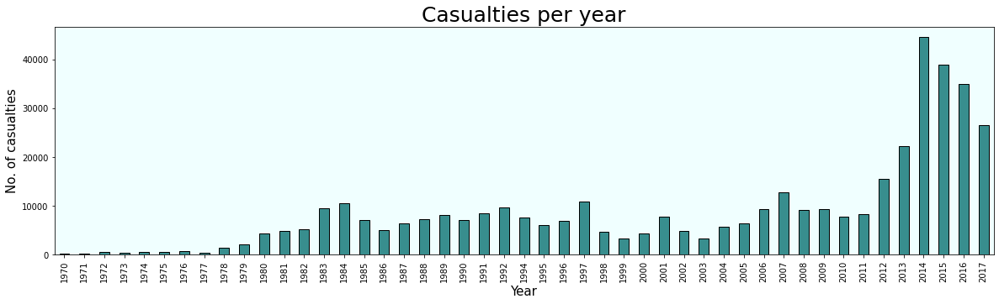

In [ ]:
# Plotting the Bar graph
casualties.plot(kind = 'bar', figsize=(20,5), color = '#388E8E', edgecolor='black').patch.set_facecolor('#f0ffff')

# Set a title of the current axes.
plt.title('Casualties per year', fontsize = 25)

# Set the x and y axis label
plt.ylabel('No. of casualties', fontsize = 15)
plt.xlabel('Year', fontsize = 15)

## Conclusion :- From the above graph in the year 2014 has the most number of casualties

## <b> 3.12 success v/s failed attacks country wise

In [ ]:
attacks =  terrorism_data_new.groupby(['success','region']).count()['attack_type'].reset_index()

In [ ]:
succ_attacks = attacks[attacks['success'] == 0]
x1 = succ_attacks.region.to_list()
y1 = succ_attacks.attack_type.to_list()

In [ ]:
fail_attacks = attacks[attacks['success'] == 1]
x2 = fail_attacks.region.to_list()
y2 = fail_attacks.attack_type.to_list()

In [ ]:
attacks_combined = succ_attacks.merge(fail_attacks, how = 'left', on = 'region')
attacks_combined_final = attacks_combined.loc[:,['region', 'attack_type_x','attack_type_y']]

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0f4a3e550>,
      dtype=object)

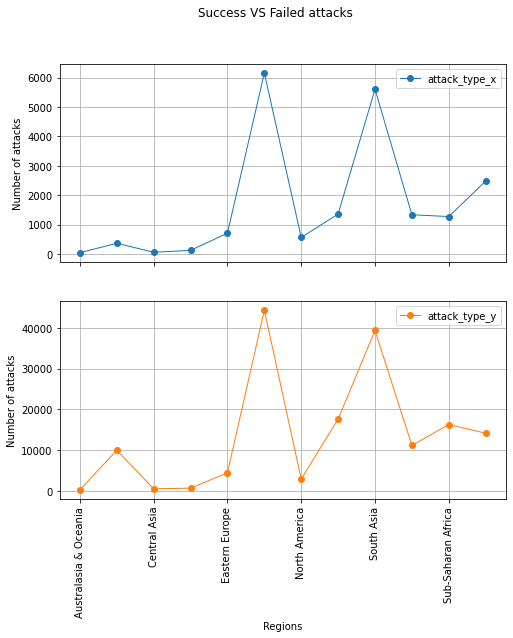

In [ ]:
attacks_combined_final.plot(x='region',y = ["attack_type_x", "attack_type_y"],title = 'Success VS Failed attacks',
                            rot = 90, subplots = True, figsize = (8,8), marker =  'o', grid = True, linewidth = 1,
                            xlabel = "Regions", ylabel = "Number of attacks")

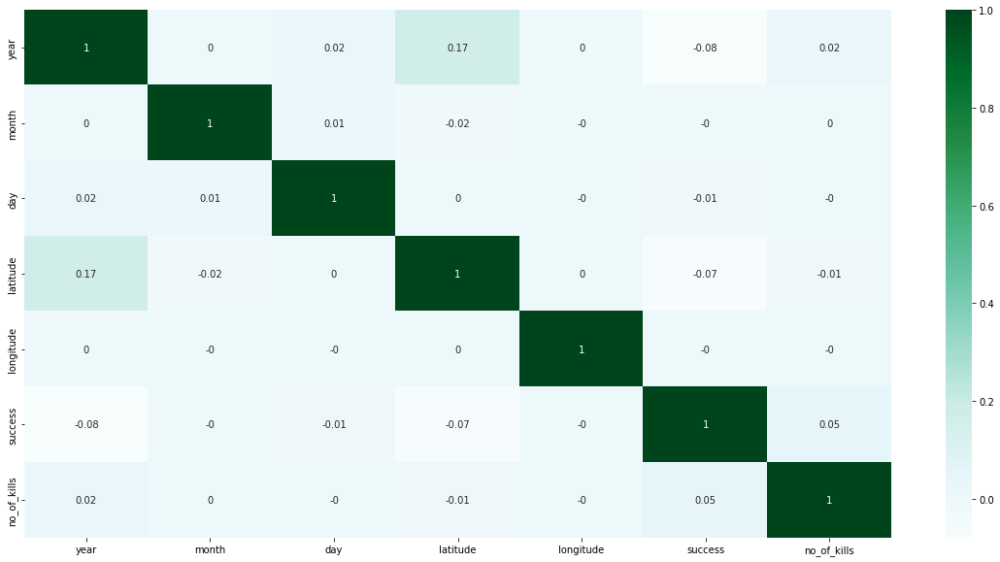

In [ ]:
plt.figure(figsize=(20,10))

sns.heatmap(np.round(terrorism_data_new.corr(),2),annot= True,cmap='BuGn')

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



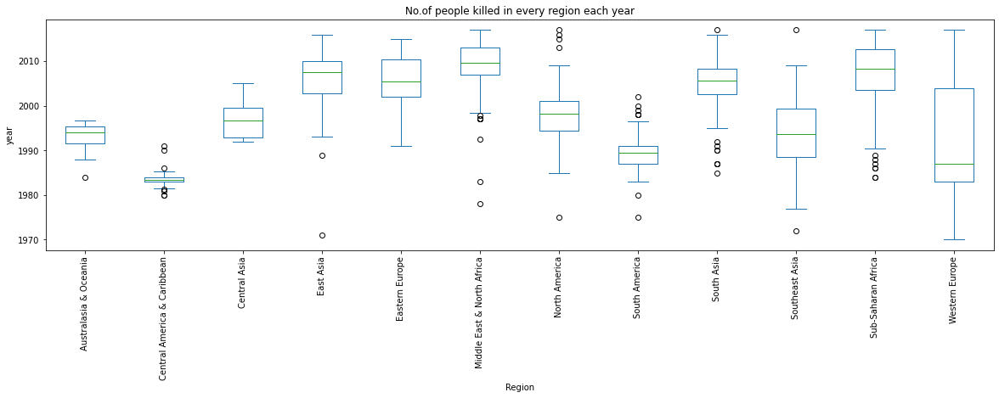

In [ ]:
# Total number of people killed in every region each year.

terrorism_data_new.groupby(['no_of_kills','region'])['year'].mean().unstack().plot(kind = 'box')
plt.title('No.of people killed in every region each year')
plt.xlabel('Region')
plt.ylabel('year')
plt.xticks(rotation = 90)
plt.rcParams['figure.figsize'] = (15, 5)